<a href="https://colab.research.google.com/github/hunarbatra/COVID-19-Mobility-Changes-EDA/blob/master/Mobility_Visualisation_AllCountries.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np                               # vectors and matrices
import pandas as pd                              # tables and data manipulations
import matplotlib.pyplot as plt                  # plots
import seaborn as sns                            # more plots

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
# Global Mobility Data
# This is the Google Global Mobility Data updated upto 17th April'20
# Link for this dataset = https://drive.google.com/open?id=1wP8615agFnTcd3ShXqYSiKqPzDaArNXV
link = '/content/drive/My Drive/Global_Mobility_Report3.csv'
df = pd.read_csv(link, header=0, usecols = lambda column : column not in ["country_region_code", "sub_region_1" , "sub_region_2"], engine = 'python', parse_dates = True)

In [4]:
df.head()
df.tail()

,country_region,date,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline
230823,Zimbabwe,2020-04-13,-71.0,-63.0,-51.0,-83.0,-80.0,49.0
230824,Zimbabwe,2020-04-14,-63.0,-53.0,-47.0,-78.0,-64.0,41.0
230825,Zimbabwe,2020-04-15,-62.0,-50.0,-51.0,-77.0,-65.0,42.0
230826,Zimbabwe,2020-04-16,-62.0,-50.0,-48.0,-77.0,-64.0,42.0
230827,Zimbabwe,2020-04-17,-62.0,-48.0,-47.0,-79.0,-62.0,43.0


In [5]:
# Number of countries in Google Mobility Data
unique_value = df["country_region"].nunique() 
print(unique_value)
# List of countries
list_of_countries = df["country_region"].unique()
print(list_of_countries)

131
['United Arab Emirates' 'Afghanistan' 'Antigua and Barbuda' 'Angola'
 'Argentina' 'Austria' 'Australia' 'Aruba' 'Bosnia and Herzegovina'
 'Barbados' 'Bangladesh' 'Belgium' 'Burkina Faso' 'Bulgaria' 'Bahrain'
 'Benin' 'Bolivia' 'Brazil' 'The Bahamas' 'Botswana' 'Belarus' 'Belize'
 'Canada' 'Switzerland' "Côte d'Ivoire" 'Chile' 'Cameroon' 'Colombia'
 'Costa Rica' 'Cape Verde' 'Czechia' 'Germany' 'Denmark'
 'Dominican Republic' 'Ecuador' 'Estonia' 'Egypt' 'Spain' 'Finland' 'Fiji'
 'France' 'Gabon' 'United Kingdom' 'Georgia' 'Ghana' 'Greece' 'Guatemala'
 'Guinea-Bissau' 'Hong Kong' 'Honduras' 'Croatia' 'Haiti' 'Hungary'
 'Indonesia' 'Ireland' 'Israel' 'India' 'Iraq' 'Italy' 'Jamaica' 'Jordan'
 'Japan' 'Kenya' 'Kyrgyzstan' 'Cambodia' 'South Korea' 'Kuwait'
 'Kazakhstan' 'Laos' 'Lebanon' 'Liechtenstein' 'Sri Lanka' 'Lithuania'
 'Luxembourg' 'Latvia' 'Libya' 'Moldova' 'North Macedonia' 'Mali'
 'Myanmar (Burma)' 'Mongolia' 'Malta' 'Mauritius' 'Mexico' 'Malaysia'
 'Mozambique' 'Namibia' 'Ni

In [0]:
# Oxford Policy Dataset 
# Link = https://drive.google.com/open?id=1nNWGk4QEEj3r1Zkrqu-mPw9zEZhXaVIB
link2 = '/content/drive/My Drive/OxCGRT_Download_240420_104244_Full.csv'
policy_data = pd.read_csv(link2, header=0, index_col=['Date'], engine = 'python', parse_dates = True)

In [7]:
# List of Countries in Oxford Dataset
list_of_countries_oxford = policy_data["CountryName"].unique()
print(list_of_countries_oxford)

['Aruba' 'Afghanistan' 'Angola' 'Albania' 'Andorra' 'United Arab Emirates'
 'Argentina' 'Australia' 'Austria' 'Azerbaijan' 'Burundi' 'Belgium'
 'Burkina Faso' 'Bangladesh' 'Bulgaria' 'Bahrain' 'Bosnia and Herzegovina'
 'Belize' 'Bermuda' 'Bolivia' 'Brazil' 'Barbados' 'Brunei' 'Botswana'
 'Canada' 'Switzerland' 'Chile' 'China' 'Cameroon'
 'Democratic Republic of Congo' 'Colombia' 'Cape Verde' 'Costa Rica'
 'Cuba' 'Cyprus' 'Czech Republic' 'Germany' 'Djibouti' 'Dominica'
 'Denmark' 'Dominican Republic' 'Algeria' 'Ecuador' 'Egypt' 'Spain'
 'Estonia' 'Ethiopia' 'Finland' 'France' 'Gabon' 'United Kingdom' 'Ghana'
 'Gambia' 'Greece' 'Greenland' 'Guatemala' 'Guam' 'Guyana' 'Hong Kong'
 'Honduras' 'Croatia' 'Hungary' 'Indonesia' 'India' 'Ireland' 'Iran'
 'Iraq' 'Iceland' 'Israel' 'Italy' 'Jamaica' 'Jordan' 'Japan' 'Kazakhstan'
 'Kenya' 'Kyrgyz Republic' 'South Korea' 'Kuwait' 'Laos' 'Lebanon' 'Libya'
 'Sri Lanka' 'Lesotho' 'Luxembourg' 'Macao' 'Morocco' 'Moldova'
 'Madagascar' 'Mexico' 'Mali' 

In [8]:
# List of Common countries in Oxford and Mobility Dataset
def intersection(list1, list2): 
    countries_list = [value for value in list1 if value in list2] 
    return countries_list

plot_countries = intersection(list_of_countries, list_of_countries_oxford).copy()
print(plot_countries)
print(len(plot_countries))

['United Arab Emirates', 'Afghanistan', 'Angola', 'Argentina', 'Austria', 'Australia', 'Aruba', 'Bosnia and Herzegovina', 'Barbados', 'Bangladesh', 'Belgium', 'Burkina Faso', 'Bulgaria', 'Bahrain', 'Bolivia', 'Brazil', 'Botswana', 'Belize', 'Canada', 'Switzerland', 'Chile', 'Cameroon', 'Colombia', 'Costa Rica', 'Cape Verde', 'Germany', 'Denmark', 'Dominican Republic', 'Ecuador', 'Estonia', 'Egypt', 'Spain', 'Finland', 'France', 'Gabon', 'United Kingdom', 'Ghana', 'Greece', 'Guatemala', 'Hong Kong', 'Honduras', 'Croatia', 'Hungary', 'Indonesia', 'Ireland', 'Israel', 'India', 'Iraq', 'Italy', 'Jamaica', 'Jordan', 'Japan', 'Kenya', 'South Korea', 'Kuwait', 'Kazakhstan', 'Laos', 'Lebanon', 'Sri Lanka', 'Luxembourg', 'Libya', 'Moldova', 'Mali', 'Mongolia', 'Mauritius', 'Mexico', 'Malaysia', 'Mozambique', 'Namibia', 'Niger', 'Nigeria', 'Nicaragua', 'Netherlands', 'Norway', 'New Zealand', 'Oman', 'Panama', 'Peru', 'Papua New Guinea', 'Philippines', 'Pakistan', 'Poland', 'Puerto Rico', 'Portug

In [0]:
# List of Dates for Plotting - x-axis
xdates = df.date.unique()
xdates = xdates.tolist()

In [0]:
def plot_country(country_name) :
  country_mobility_data = df.loc[df['country_region'] == country_name] # 15/02 .... 17/04
  if(country_name == 'Israel'): # In the Global Mobility Dataset, the data for Israel is only available upto 11th April'20. For the rest it is upto 17th April'20
    dates = xdates[:len(xdates)-6] # Removing the last 6 dates -- 12...17th April'20 from the x-axis
    country_mobility_data = country_mobility_data.head(57) # 15th Feb .... 11th April
  else:
    dates = xdates # Else, x axis dates remain the same
    country_mobility_data = country_mobility_data.head(63) # 15th Feb .... 17th April
    
  country_policies = policy_data.loc[policy_data['CountryName'] == country_name]
  country_policies = country_policies.iloc[45:] # remove 1/1 .... 14/02 policy data

  fig, ax = plt.subplots(figsize=(24,12))
  ax.plot_date(dates, country_mobility_data.retail_and_recreation_percent_change_from_baseline, linestyle='--', label='Retail and Recreation')
  ax.plot_date(dates, country_mobility_data.grocery_and_pharmacy_percent_change_from_baseline, linestyle='--', label = 'Grocery and Pharmacy')
  ax.plot_date(dates, country_mobility_data.parks_percent_change_from_baseline, linestyle='--', label = 'Parks')
  ax.plot_date(dates, country_mobility_data.transit_stations_percent_change_from_baseline, linestyle='--', label = 'Transit Stations')
  ax.plot_date(dates, country_mobility_data.workplaces_percent_change_from_baseline, linestyle='--', label = 'Workplaces')
  ax.plot_date(dates, country_mobility_data.residential_percent_change_from_baseline, linestyle='--', label = 'Residential')

  school = country_policies['S1_School closing'].tolist()
  for x in range(len(school)):
    if school[x] > 0: # if the policy is there i.e value will be 1 .... add an arrow annotation at that point
      ax.annotate("School Closure", xy=(dates[x], 0), bbox=dict(boxstyle="round", alpha=0.2), size=15, xytext=(50, 150), textcoords='offset points', ha='center',  
                  arrowprops=dict(facecolor='black', shrink=0.05))
      break

  workplace = country_policies['S2_Workplace closing'].tolist() 
  for x in range(len(workplace)):
    if workplace[x] > 0: # if the policy is there i.e value will be 1 .... add an arrow annotation at that point
      ax.annotate("Workplace Closure", xy=(dates[x], 0), bbox=dict(boxstyle="round", alpha=0.2), size=15, xytext=(-20, 80), textcoords='offset points', ha='center',  
                  arrowprops=dict(facecolor='black', shrink=0.05))
      break

  public_events = country_policies['S3_Cancel public events'].tolist()
  for x in range(len(public_events)):
    if public_events[x] > 0: # if the policy is there i.e value will be 1 .... add an arrow annotation at that point
      ax.annotate("Public Events Cancellation", xy=(dates[x], 0), bbox=dict(boxstyle="round", alpha=0.2), size=15, xytext=(100, 120), textcoords='offset points', ha='center',  
                  arrowprops=dict(facecolor='black', shrink=0.05))
      break

  transport = country_policies['S4_Close public transport'].tolist()
  for x in range(len(transport)):
    if transport[x] > 0: # if the policy is there i.e value will be 1 .... add an arrow annotation at that point
      ax.annotate("Public Transport Closure", xy=(dates[x], 0), bbox=dict(boxstyle="round", alpha=0.2), size=15, xytext=(120, 120), textcoords='offset points', ha='center',  
                  arrowprops=dict(facecolor='black', shrink=0.05))
      break

  public_info = country_policies['S5_Public information campaigns'].tolist()
  for x in range(len(public_info)):
    if public_info[x] > 0: # if the policy is there i.e value will be 1 .... add an arrow annotation at that point
      ax.annotate("Public Info Campaigns", xy=(dates[x], 0), bbox=dict(boxstyle="round", alpha=0.2), size=15, xytext=(40, 80), textcoords='offset points', ha='center',  
                  arrowprops=dict(facecolor='black', shrink=0.05))
      break

  movement = country_policies['S6_Restrictions on internal movement'].tolist()
  for x in range(len(movement)):
    if movement[x] > 0: # if the policy is there i.e value will be 1 .... add an arrow annotation at that point
      ax.annotate("Internal Movement Restriction", xy=(dates[x], 0), bbox=dict(boxstyle="round", alpha=0.2), size=15, xytext=(20, 160), textcoords='offset points', ha='center',  
                  arrowprops=dict(facecolor='black', shrink=0.05))
      break

  travel = country_policies['S7_International travel controls'].tolist()
  for x in range(len(travel)):
    if travel[x] > 0: # if the policy is there i.e value will be 1 .... add an arrow annotation at that point
      ax.annotate("International Travel Controls", xy=(dates[x], 0), bbox=dict(boxstyle="round", alpha=0.2), size=15, xytext=(70, -150), textcoords='offset points', ha='center',  
                  arrowprops=dict(facecolor='black', shrink=0.05))
      break

  plt.title(country_name)
  plt.grid(True)
  plt.xlabel("Dates")
  plt.ylabel("% Change in Mobility")
  plt.legend(loc="best")
  plt.axis('tight')
  plt.style.context('seaborn-white')
  plt.xticks(rotation=45)
  plt.show()

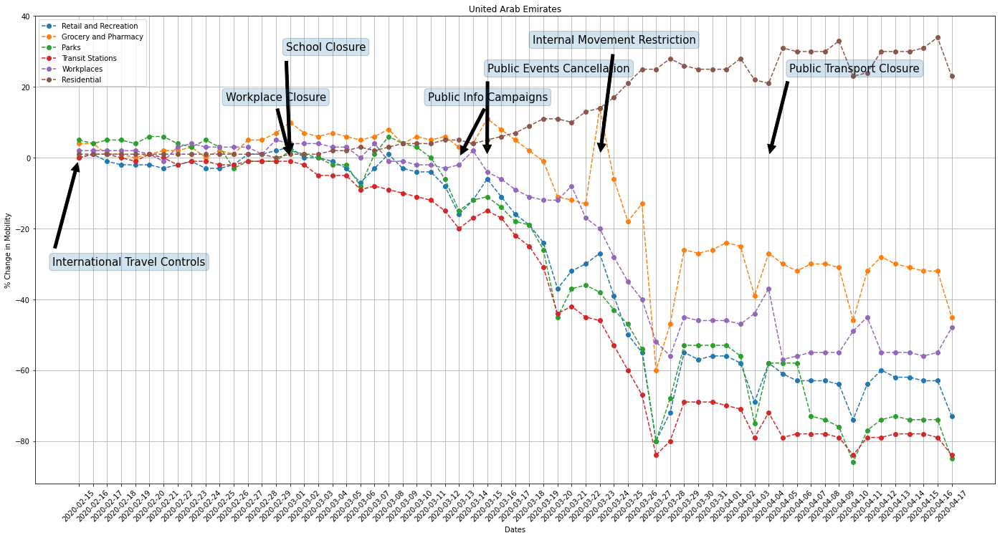

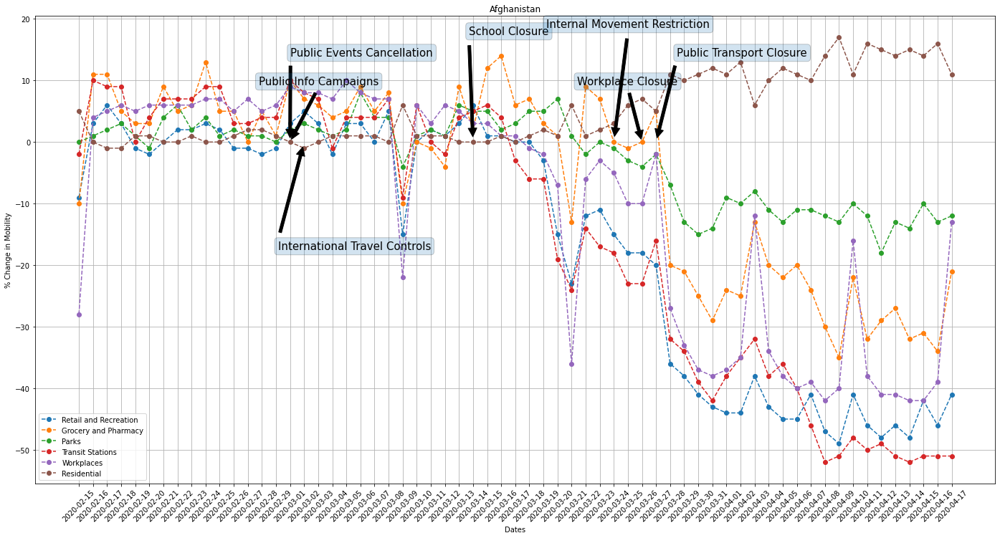

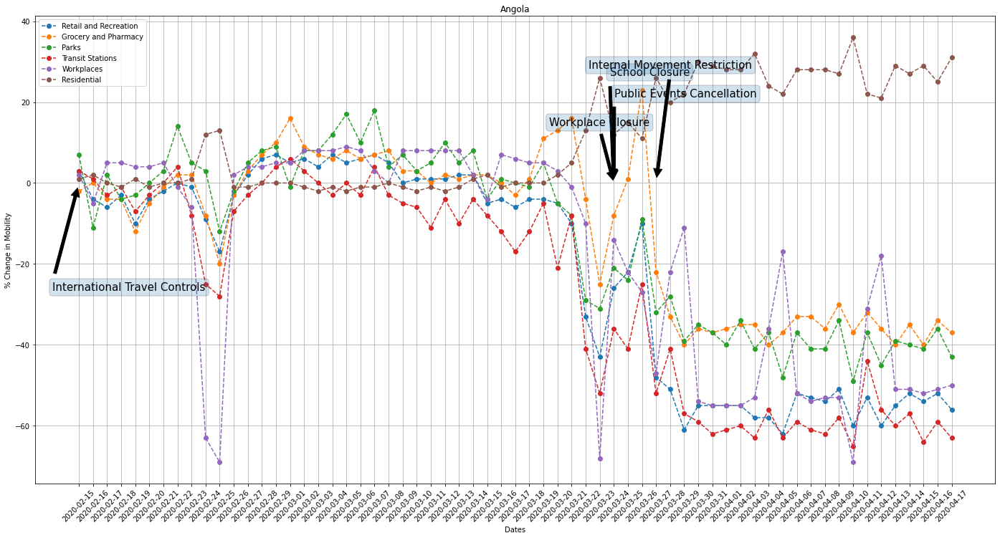

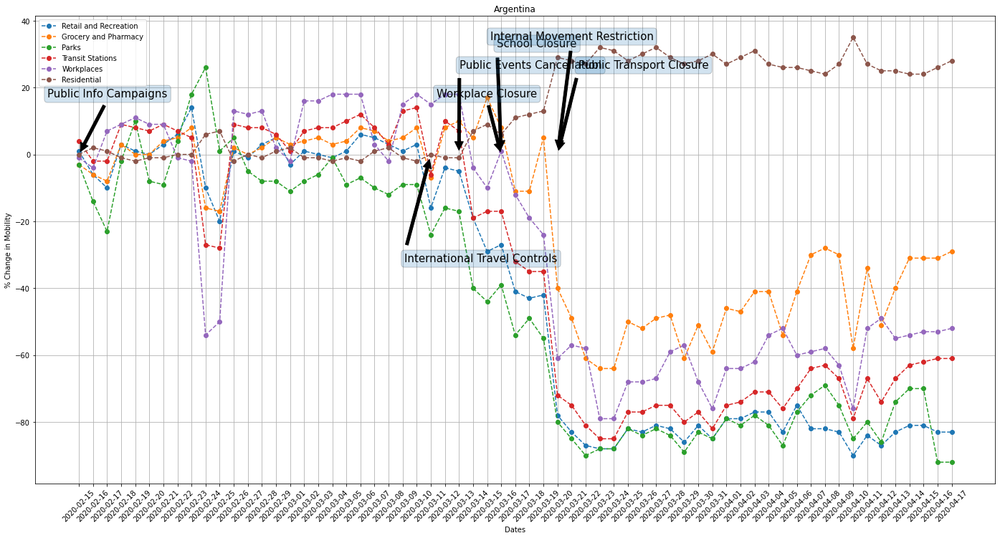

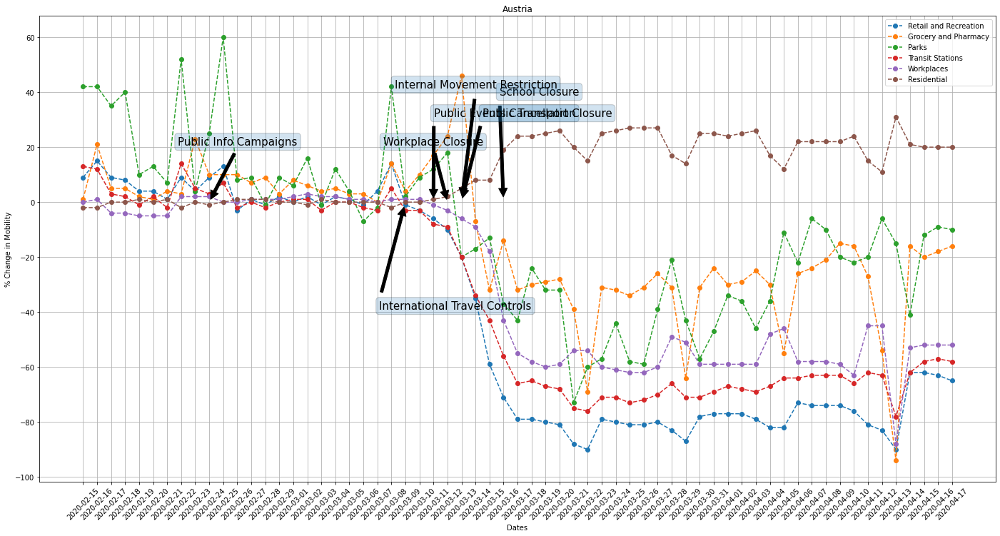

...

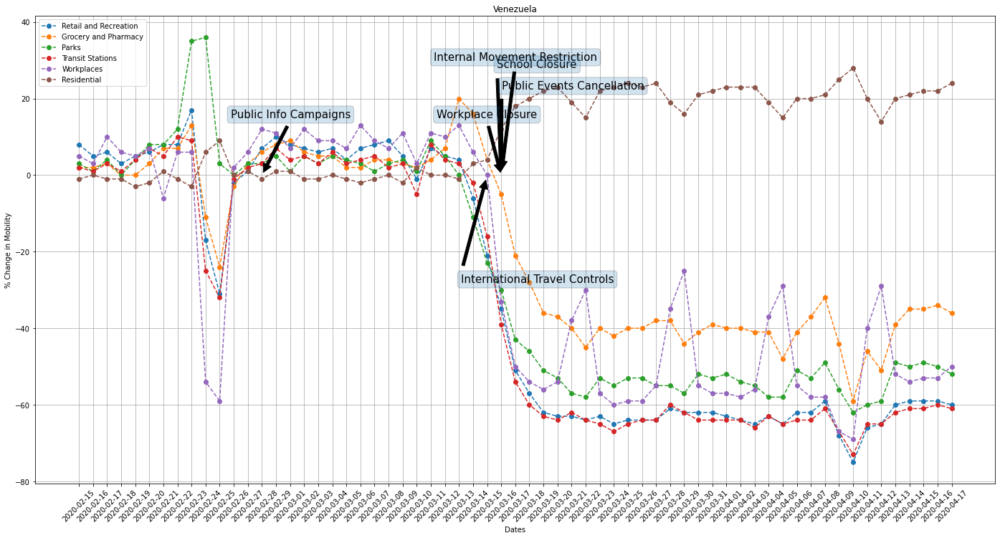

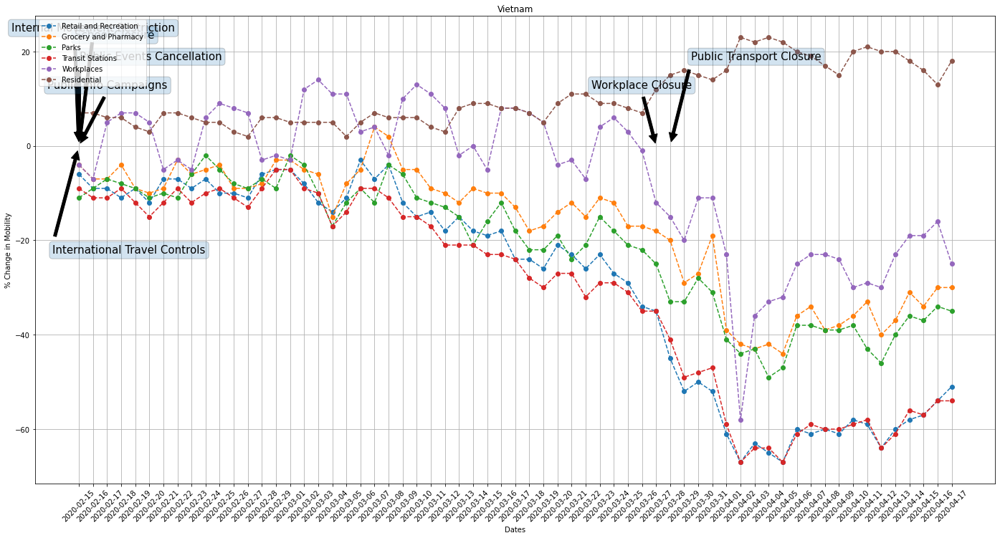

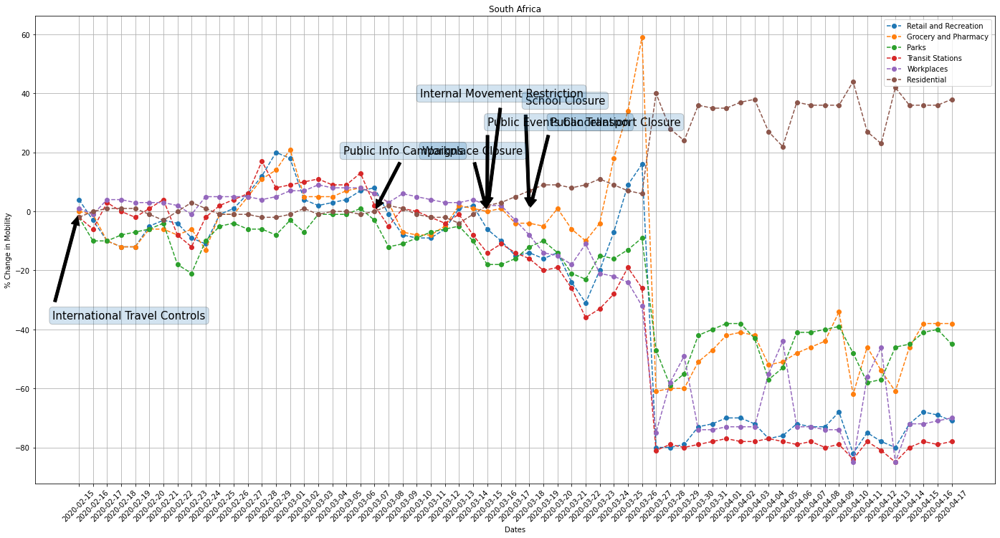

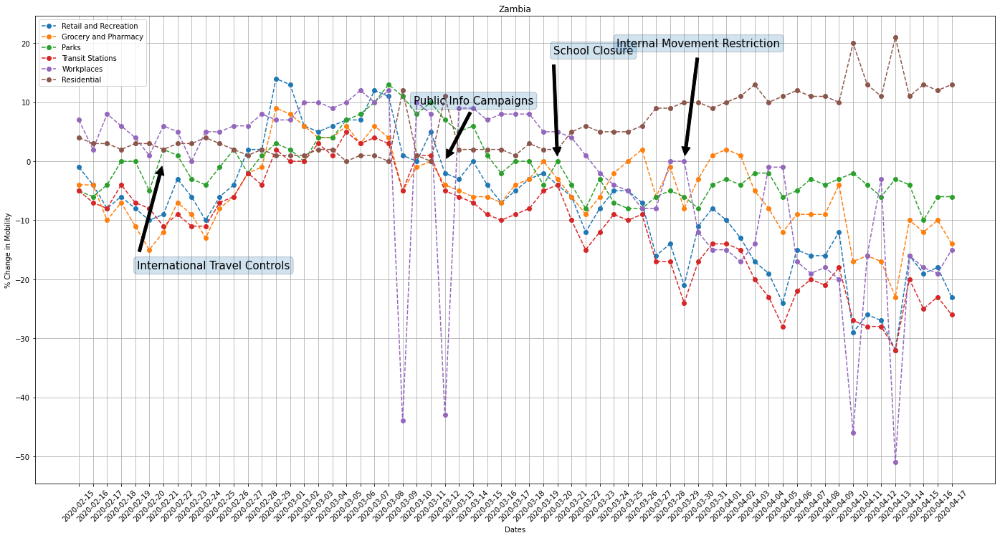

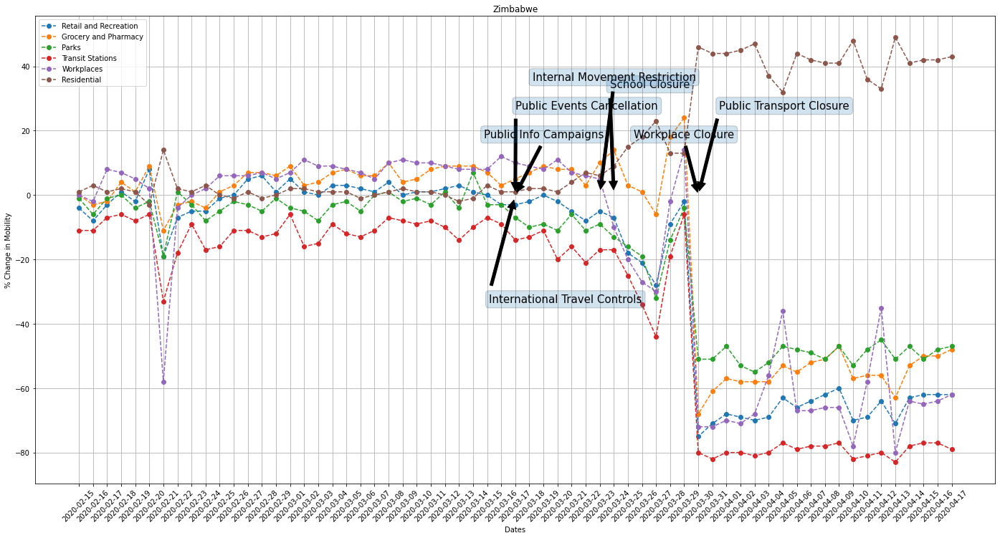

In [16]:
# Plot the graph for every country in plot_countries i.e for 106 countries
for country in plot_countries:
  plot_country(country) 